In [1]:
from transformers import AutoProcessor, AutoModelForImageTextToText, AutoModelForZeroShotObjectDetection
from qwen_vl_utils import process_vision_info
from PIL import Image
import matplotlib.pyplot as plt
import torch
import json
import requests
from requests.adapters import HTTPAdapter
from requests.packages.urllib3.util.retry import Retry
import os

/Users/kevinxu/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
/Users/kevinxu/Library/Python/3.9/lib/python/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
if torch.cuda.is_available():
    device = "cuda"
elif torch.backends.mps.is_available():
    device = "mps"
else:
    device = "cpu"

In [3]:
# Load QWEN2-vl  model
input_processor = AutoProcessor.from_pretrained("Qwen/Qwen2-VL-2B-Instruct")
input_model = AutoModelForImageTextToText.from_pretrained("Qwen/Qwen2-VL-2B-Instruct").to(device)

dino_processor = AutoProcessor.from_pretrained("IDEA-Research/grounding-dino-tiny")
dino_model = AutoModelForZeroShotObjectDetection.from_pretrained("IDEA-Research/grounding-dino-tiny").to(device)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.48, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
Loading checkpoint shards: 100%|██████████| 2/2 [00:02<00:00,  1.27s/it]


In [5]:
coco_dataset = open("../instances_val2017.json")
coco_json = json.load(coco_dataset)
coco_images = coco_json["images"]
coco_annotations = coco_json["annotations"]
coco_categories = coco_json["categories"]
inputs_url = []
image_url = []

category_validation_images = {}
id_category_mapping = {}

# Get mappings of id number and category name
for category in coco_categories:
    category_validation_images[category["id"]] = []
    id_category_mapping[category["id"]] = category["name"]

# For each category, get all images with that category annotation
for images in coco_images:
    image_inputs = []
    for anno in coco_annotations:
        if anno["image_id"] == images["id"]:
            for categories in coco_categories:
                if anno["category_id"] == categories["id"]:
                    if images not in category_validation_images[anno["category_id"]]:
                        category_validation_images[anno["category_id"]].append(images)

In [6]:
def requests_retry_session(
    retries=100,
    backoff_factor=0.3,
    status_forcelist=(500, 502, 504),
    session=None,
):
    session = session or requests.Session()
    retry = Retry(
        total=retries,
        read=retries,
        connect=retries,
        backoff_factor=backoff_factor,
        status_forcelist=status_forcelist,
    )
    adapter = HTTPAdapter(max_retries=retry)
    session.mount('http://', adapter)
    session.mount('https://', adapter)
    return session

In [7]:
def plot_results(image, result, category, caption, prompt_image):
    boxes = result["boxes"]
    scores = result["scores"]
    labels = result["labels"]
    fig, axes = plt.subplots(1, 2, figsize = (8, 4))
    plt.axis("off")
    # Plot validation image
    fig.suptitle(f"Category: {category}\nCaption: {caption}")
    axes[0].imshow(image)
    axes[0].set_title("Validation Image")
    axes[0].axis("off")
    colors = plt.cm.hsv(torch.linspace(0, 1, len(boxes))).tolist()
    
    # Add box
    for box, score, label, color in zip(boxes, scores, labels, colors):
        xmin, ymin, xmax, ymax = box.tolist()
        axes[0].add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill = False, color = color, linewidth = 2))
        text = f"{label}: {score:.2f}"
        axes[0].text(xmin, ymin, text, bbox = dict(facecolor = "yellow", alpha = 0.5))
    
    # Plot prompt image
    axes[1].imshow(prompt_image)
    axes[1].set_title("Prompt Image")
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

/var/folders/6m/288j1hf95f11bm2jzx6bh6d40000gn/T/ipykernel_1639/1715423328.py:52: FutureWarning: `box_threshold` is deprecated and will be removed in version 4.51.0 for `GroundingDinoProcessor.post_process_grounded_object_detection`. Use `threshold` instead.
  results = dino_processor.post_process_grounded_object_detection(
/Users/kevinxu/Library/Python/3.9/lib/python/site-packages/transformers/models/grounding_dino/processing_grounding_dino.py:95: FutureWarning: The key `labels` is will return integer ids in `GroundingDinoProcessor.post_process_grounded_object_detection` output since v4.51.0. Use `text_labels` instead to retrieve string object names.
  warnings.warn(self.message, FutureWarning)


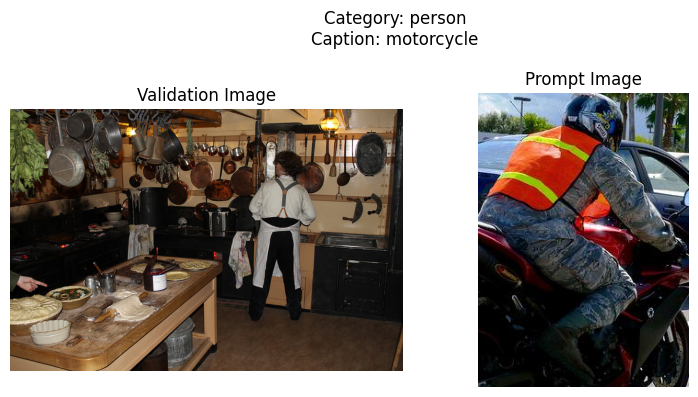

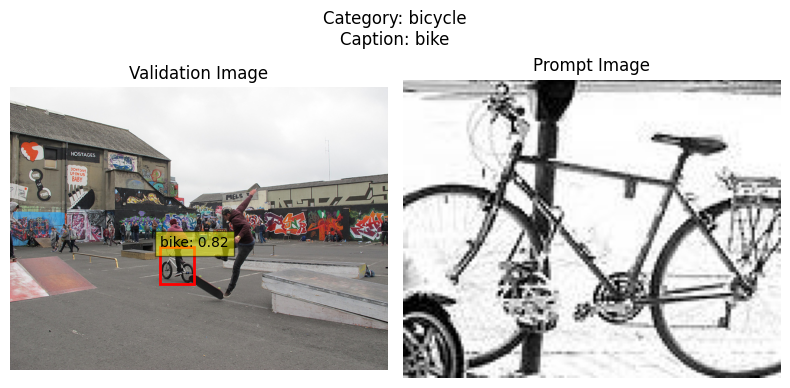

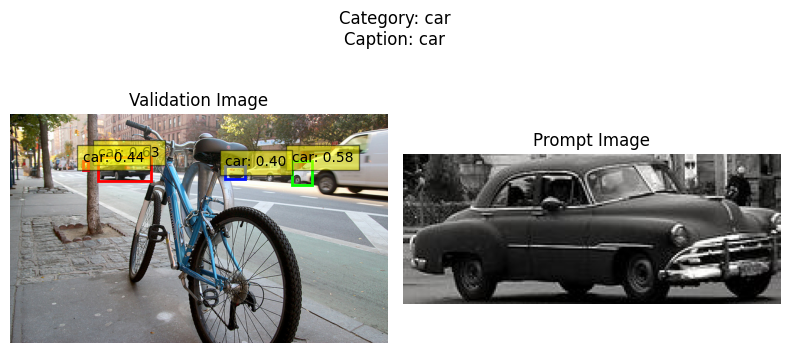

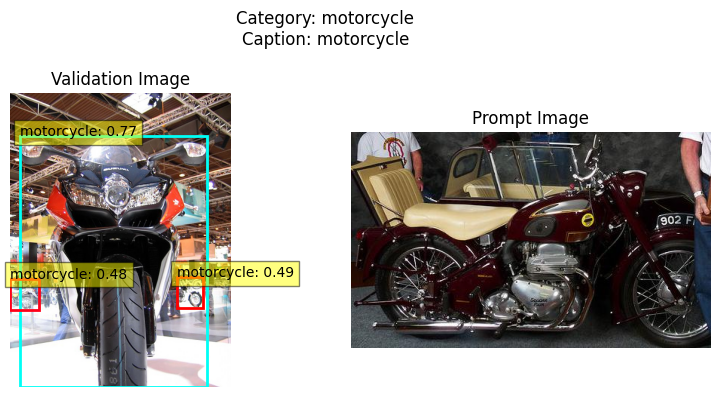

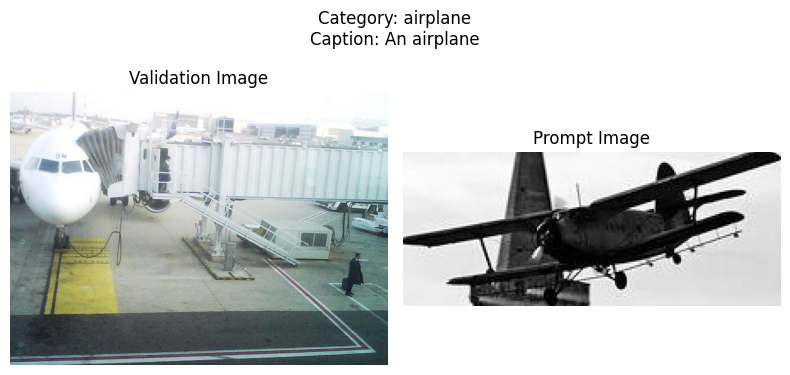

...

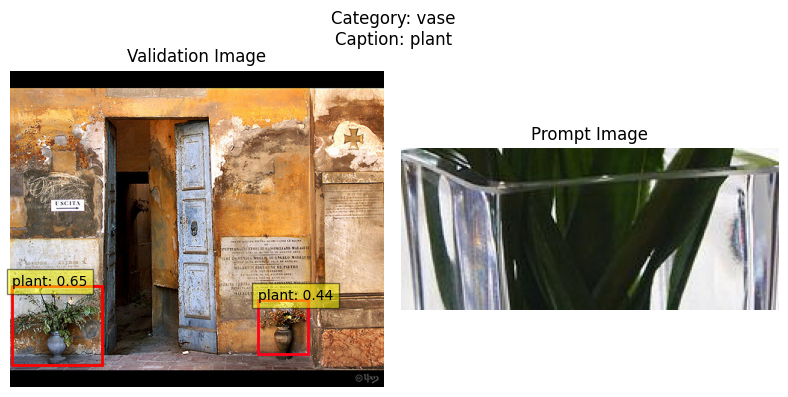

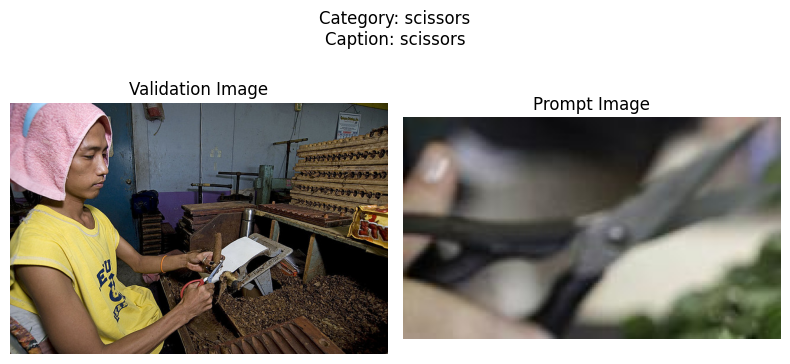

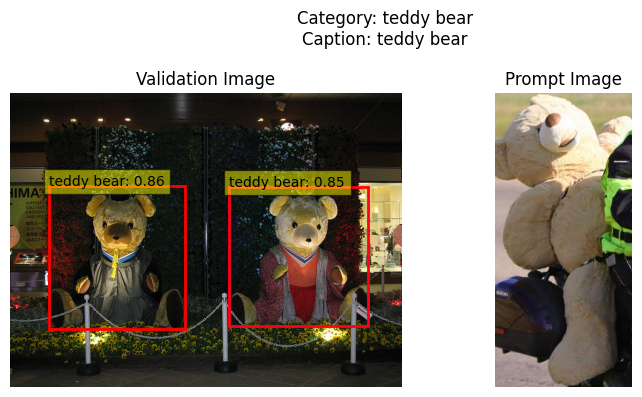

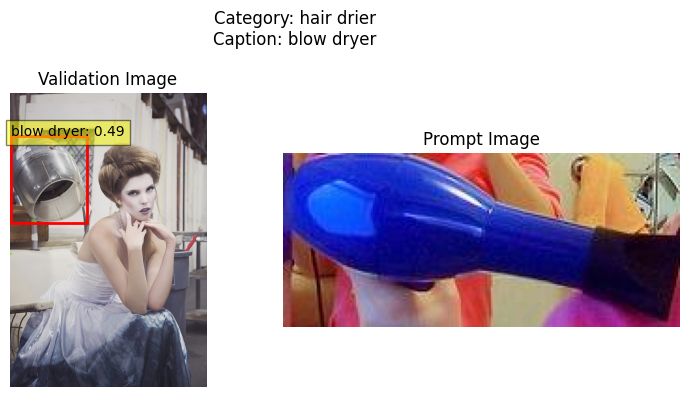

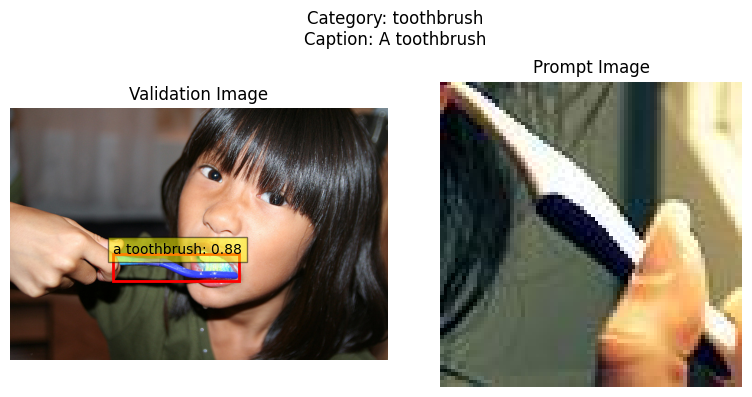

In [8]:
# Number of cropped images in the cateogry to go through
num_cropped_images = 1

# Number of validation images in the category to go through
num_validation_images = 1
category_ids = list(category_validation_images.keys())
# Go through every category
for id in category_ids:
    # All validation images under the category
    images = category_validation_images[id]
    category = id_category_mapping[id]

    # Go thruogh cropped images
    for i in range(num_cropped_images):
        # Open cropped image
        cropped_file = f"../data/cropped_objects/{category}_{i + 1}.jpg"
        prompt_image = Image.open(cropped_file)
        prompt = [
        {
            "role": "user",
            "content": [
                {"type": "image", "image": prompt_image},
                {"type": "text", "text": "What is in the image? Only give your answer."}
            ]
        }]

        text = input_processor.apply_chat_template(prompt, tokenize = False, add_generation_prompt = True)
        image_inputs, video_inputs = process_vision_info(prompt)

        inputs = input_processor(
            text = [text],
            images = image_inputs,
            videos = video_inputs,
            padding = True,
            return_tensors = "pt",
        ).to(device)

        input_model_output = input_model.generate(**inputs, max_new_tokens = 64)
        generated_text = input_processor.decode(input_model_output[0], skip_special_tokens=True)
        generated_caption = generated_text.split("\n")[-1]

        # Go through validation iamges
        for i in range(num_validation_images):
            # Open validation image
            image = Image.open(requests_retry_session().get(images[i]["coco_url"], stream=True).raw)

            # Pass caption and image to grounding dino
            text_labels = [generated_caption]
            inputs = dino_processor(images=image, text=text_labels, return_tensors="pt").to(device)
            with torch.no_grad():
                outputs = dino_model(**inputs)
            results = dino_processor.post_process_grounded_object_detection(
                outputs,
                inputs.input_ids,
                box_threshold=0.4,
                text_threshold=0.3,
                target_sizes=[image.size[::-1]]
            )

            # Plot output and prompt image
            plot_results(image, results[0], category, generated_caption, prompt_image)